In [1]:
import gradio as gr
import numpy as np
import IPython
from IPython.display import Audio, display
import torch
import librosa, librosa.display
from tqdm import tqdm
import json

# import sys  
# sys.path.insert(0, '../')
from audioldm2 import text_to_audio, build_model, seed_everything, make_batch_for_text_to_audio
from audioldm2.latent_diffusion.modules.diffusionmodules.util import (
    make_ddim_sampling_parameters,
    make_ddim_timesteps,
    noise_like,
    extract_into_tensor,
)
from audioldm2.latent_diffusion.models.ddim import DDIMSampler
from audioldm2.utilities import *
from audioldm2.utilities.audio import *
from audioldm2.utilities.data import *
from audioldm2.utils import default_audioldm_config

from audioldm2.gaverutils import gaver_sounds

%matplotlib inline
import matplotlib.pyplot as plt

In [2]:
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

In [3]:
%reload_ext autoreload

In [4]:
%matplotlib inline

In [5]:
import warnings

def fxn():
    warnings.warn("deprecated", DeprecationWarning)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    fxn()


In [6]:
audioldm = None
current_model_name = None

model_name = 'audioldm_16k_crossattn_t5' # doesnt work very well? But the only thing that fits on my machine
# model_name = 'audioldm2-full' # Needs more memory than what I have
# model_name = 'audioldm_48k'

latent_diffusion=build_model(model_name=model_name)

Loading AudioLDM-2: audioldm_16k_crossattn_t5
Loading model on cuda:0
{'variables': {'sampling_rate': 16000, 'mel_bins': 64, 'latent_embed_dim': 8, 'latent_t_size': 256, 'latent_f_size': 16, 'in_channels': 8, 'optimize_ddpm_parameter': True, 'warmup_steps': 5000}, 'step': {'validation_every_n_epochs': 1, 'save_checkpoint_every_n_steps': 5000, 'max_steps': 1500000, 'save_top_k': 2}, 'preprocessing': {'audio': {'sampling_rate': 16000, 'max_wav_value': 32768, 'duration': 10.24}, 'stft': {'filter_length': 1024, 'hop_length': 160, 'win_length': 1024}, 'mel': {'n_mel_channels': 64, 'mel_fmin': 0, 'mel_fmax': 8000}}, 'augmentation': {'mixup': 0}, 'model': {'target': 'audioldm2.latent_diffusion.models.ddpm.LatentDiffusion', 'params': {'first_stage_config': {'base_learning_rate': 8e-06, 'target': 'audioldm2.latent_encoder.autoencoder.AutoencoderKL', 'params': {'sampling_rate': 16000, 'batchsize': 4, 'monitor': 'val/rec_loss', 'image_key': 'fbank', 'subband': 1, 'embed_dim': 8, 'time_shuffle': 1

/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torchaudio/transforms/_transforms.py:580: UserWarning: Argument 'onesided' has been deprecated and has no influence on the behavior of this module.
  warnings.warn(


DiffusionWrapper has 265.53 M params.


/home/purnima/anaconda3/envs/audioldm2/lib/python3.8/site-packages/torch/nn/utils/weight_norm.py:28: UserWarning: torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.
  warnings.warn("torch.nn.utils.weight_norm is deprecated in favor of torch.nn.utils.parametrizations.weight_norm.")


In [28]:
def sample_diffusion(batch, x_init=None, random_seed=45, attention_weights=None):
    with torch.no_grad():
        seed_everything(int(random_seed))
        if x_init is None:
            x_init = torch.randn((1, 8, 256, 16), device="cuda")

        
        text_conditioning = batch["text"]

        # The logic behind creating this "conditioning dict" is a little convoluted. 
        # We are able to use only text for conditioning, but for some reason the system expects other MAE related values to be
        # set on the dict. Anyways... junk code - but works. 
        cond_batch = make_batch_for_text_to_audio(text_conditioning[0], transcription="", waveform=None, batchsize=batch_size)
        _, c = latent_diffusion.get_input(cond_batch, latent_diffusion.first_stage_key,unconditional_prob_cfg=0.0)  # Do not output unconditional information in the c
        cond_dict = latent_diffusion.filter_useful_cond_dict(c)

        uncond_dict = {}
        for key in latent_diffusion.cond_stage_model_metadata:
            model_idx = latent_diffusion.cond_stage_model_metadata[key]["model_idx"]
            uncond_dict[key] = latent_diffusion.cond_stage_models[
                model_idx
            ].get_unconditional_condition(batch_size)
        

        shape = (latent_diffusion.channels, latent_diffusion.latent_t_size, latent_diffusion.latent_f_size)
        device=latent_diffusion.device
        eta=1.0
        temperature = 1.0
        noise = noise_like(x_init.shape, device, repeat=False) * temperature

        ddim_sampler = DDIMSampler(latent_diffusion, device=device)
        ddim_sampler.make_schedule(ddim_num_steps=ddim_steps, ddim_eta=eta, verbose=False)
        
        timesteps = ddim_sampler.ddim_timesteps

        intermediates = {"x_prev": [x_init], "predicted_noise_orig": [x_init], "predicted_noise_sega": [x_init]}
        time_range = np.flip(timesteps)
        total_steps = timesteps.shape[0]
        print(f"Running DDIM Sampling with {total_steps} timesteps")
        iterator = tqdm(time_range, desc="DDIM Sampler", total=total_steps)
    
        for i, step in enumerate(iterator):
            index = total_steps - i - 1
            t_in = torch.full((batch_size,), step, device=device, dtype=torch.long)
    
            #from p_sample_ddim
            model_uncond = ddim_sampler.model.apply_model(x_init, t_in, uncond_dict) #Unconditioned epsilon estimate
            model_cond = ddim_sampler.model.apply_model(x_init, t_in, cond_dict, attention_weights=attention_weights) #Conditioned epsilon estimate


            
            # CFG; model_output is the estimated error after CFG
            e_t = model_cond + guidance_scale * (model_cond - model_uncond)

        
            alphas = ddim_sampler.ddim_alphas
            alphas_prev = ddim_sampler.ddim_alphas_prev
    
            sqrt_one_minus_alphas = ddim_sampler.ddim_sqrt_one_minus_alphas
            sigmas = ddim_sampler.ddim_sigmas
            
            # select parameters corresponding to the currently considered timestep
            a_t = torch.full((batch_size, 1, 1, 1), alphas[index], device=device)
            a_prev = torch.full((batch_size, 1, 1, 1), alphas_prev[index], device=device)
            sigma_t = torch.full((batch_size, 1, 1, 1), sigmas[index], device=device)
            sqrt_one_minus_at = torch.full((batch_size, 1, 1, 1), sqrt_one_minus_alphas[index], device=device)
    
            noise = sigma_t * noise_like(x_init.shape, device, repeat=False) * temperature
            
            pred_x0 = (x_init - sqrt_one_minus_at * e_t) / a_t.sqrt()
            dir_xt = (1.0 - a_prev - sigma_t**2).sqrt() * e_t
            x_prev = a_prev.sqrt() * pred_x0 + dir_xt + noise
            
    
            x_init = x_prev
            #return x_prev, pred_x0, e_t, model_uncond => img, pred_x0, predicted_noise, predicted_uncond_noise
    
            log_every_t = 1
            if index % log_every_t == 0 or index == total_steps - 1:
                intermediates["x_prev"].append(x_prev)
                intermediates["predicted_noise_orig"].append(e_t)
    
        mel = latent_diffusion.decode_first_stage(x_prev)
        waveform = latent_diffusion.mel_spectrogram_to_waveform(
            mel, savepath="", bs=None, name="", save=False
        )
        return mel, waveform, model_cond, model_uncond, e_t, intermediates 
        #=> mel of estimated z; wav of estimated z; predicted noise (epsilon); predicted noise unconditional; predicted noise with CFG

In [8]:
def plot(waveform, predicted_noise, predicted_uncond_noise):
    epsilon_noise = noise_to_mel_to_wave(predicted_noise)
    epsilon_noise_uncond = noise_to_mel_to_wave(predicted_uncond_noise)
    
    IPython.display.display(IPython.display.Audio(waveform[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(epsilon_noise[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(epsilon_noise_uncond[0][0], rate=16000))
    
    %matplotlib inline
    
    fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15,5))
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(waveform[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(epsilon_noise[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(epsilon_noise_uncond[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[2])
    
    torch.norm(predicted_noise), torch.norm(predicted_uncond_noise)

def plot_wavs(wav1, wav2):
    IPython.display.display(IPython.display.Audio(wav1[0][0], rate=16000))
    IPython.display.display(IPython.display.Audio(wav2[0][0], rate=16000))

    %matplotlib inline
    
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(wav1[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[0])
    axs[0].set_title('wav1') 
    
    D = librosa.amplitude_to_db(np.abs(librosa.stft(wav2[0][0], hop_length=512)),ref=np.max)
    librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[1])
    axs[1].set_title('wav2') 

def plot_all(wavs):
    %matplotlib inline
    nrows = len(wavs)//4 
    if len(wavs)%4 > 0:
        nrows += 1
    print('num rows=', nrows)
    fig, axs = plt.subplots(nrows=nrows, ncols=4, figsize=(15,5))
    for i, wav in enumerate(wavs):
        nrow = i//4
        ncol = i%4
        IPython.display.display(IPython.display.Audio(wav[0][0], rate=16000))

        D = librosa.amplitude_to_db(np.abs(librosa.stft(wav[0][0], hop_length=512)),ref=np.max)
        if nrows>1:
            librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[nrow][ncol])
        else:
            librosa.display.specshow(D, y_axis='linear', sr=16000, hop_length=512, x_axis='time', ax=axs[ncol])

def noise_to_mel_to_wave(predicted_noise):
    mel = latent_diffusion.decode_first_stage(predicted_noise)
    waveform = latent_diffusion.mel_spectrogram_to_waveform(
        mel, savepath="", bs=None, name="somename", save=False
    )
    return waveform

In [9]:
plt.close()

In [10]:
latent_t_per_second=25.6
sample_rate=16000
duration = 10.0 #Duration is minimum 10 secs. The generated sounds are weird for <10secs
guidance_scale = 3
random_seed = 43
n_candidates = 1
batch_size = 1
ddim_steps = 20

fbank = torch.zeros((batch_size, 1024, 64))
stft = torch.zeros((batch_size, 1024, 512))
waveform = torch.zeros((batch_size, 160000))

seed_everything(int(random_seed))
x_T = torch.randn((1, 8, 256, 16), device="cuda")

latent_diffusion.latent_t_size = int(duration * latent_t_per_second)

In [11]:
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text(['A drumstick is continuously hitting a hard metal surface in a large room'])
print(context.shape)

#13 words. 17 tokens. Last token in every sentence is 'None'

torch.Size([1, 17, 1024])


In [12]:
# latent_diffusion.model.diffusion_model

## Words to Tokens

In [15]:
text = "A drumstick is continuously scratching a hard metal surface in a large room"

latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping([text])

Token for each word in sentence => [[0], [1, 2], [3], [4], [5, 6], [7, 8], [9], [10], [11], [12], [13, 14], [15], [16]] torch.Size([18])
A [0]
drumstick [1, 2]
is [3]
continuously [4]
scratching [5, 6]
a [7, 8]
hard [9]
metal [10]
surface [11]
in [12]
a [13, 14]
large [15]
room [16]


## Modify hardness of the surface

Token for each word in sentence => [[0], [1, 2], [3], [4], [5], [6, 7], [8], [9], [10], [11], [12, 13], [14], [15]] torch.Size([17])
A [0]
drumstick [1, 2]
is [3]
continuously [4]
hitting [5]
a [6, 7]
hard [8]
metal [9]
surface [10]
in [11]
a [12, 13]
large [14]
room [15]
torch.Size([1, 17, 1024])
tensor([ 1,  1,  1,  1,  1,  1,  1,  1, -2,  1,  1,  1,  1,  1,  1,  1,  1],
       device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.45it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,  1,  1],
       device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.57it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.58it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.56it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.55it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.54it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.57it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 5, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.60it/s]


num rows= 2


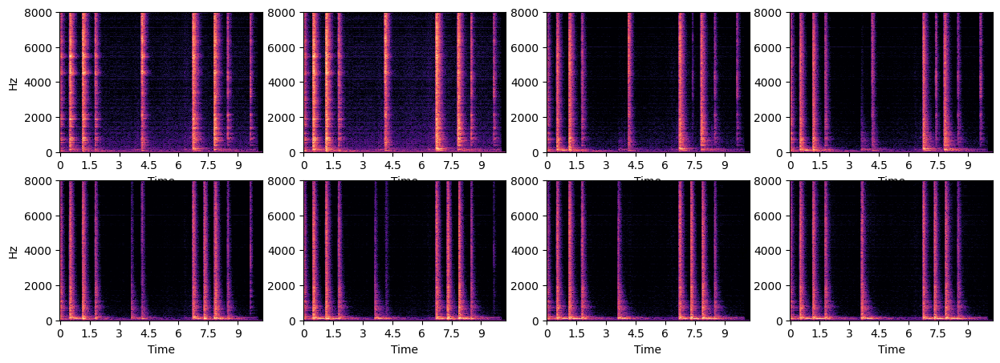

In [31]:
text = "A drumstick is continuously hitting a hard metal surface in a large room"

text = [text] * batch_size
batch = {
        "text": text,  # list
        "fname": ['some-name']  # list
}


#Attention reweight
latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(text) #print the mapping
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text([text][0])
print(context.shape)
attention_weights = torch.from_numpy(np.array([1 for i in range(context.shape[1])])).cuda()

wavs = []

interp_range = [i for i in np.arange(-2, 6, 1)]
for attention_weight in interp_range:
    attention_weights[8] = attention_weight
    print(attention_weights)

    predicted_mel, predicted_wav, predicted_noise, predicted_uncond_noise, predicted_noise_with_cfg, intermediates = \
    sample_diffusion(batch, attention_weights=attention_weights, random_seed=42)

    wavs.append(predicted_wav)
    
plot_all(wavs)

## Modify the level of reverb

Token for each word in sentence => [[0], [1, 2], [3], [4], [5], [6, 7], [8], [9], [10], [11], [12, 14]] torch.Size([16])
A [0]
drumstick [1, 2]
is [3]
continuously [4]
hitting [5]
a [6, 7]
hard [8]
metal [9]
surface [10]
with [11]
reverb [12, 14]
torch.Size([1, 16, 1024])
tensor([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -2,  1, -2,  1],
       device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.26it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,  1, -1,  1],
       device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.60it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.58it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.66it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.59it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 1, 3, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.66it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 4, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.60it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 5, 1, 5, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.56it/s]


num rows= 2


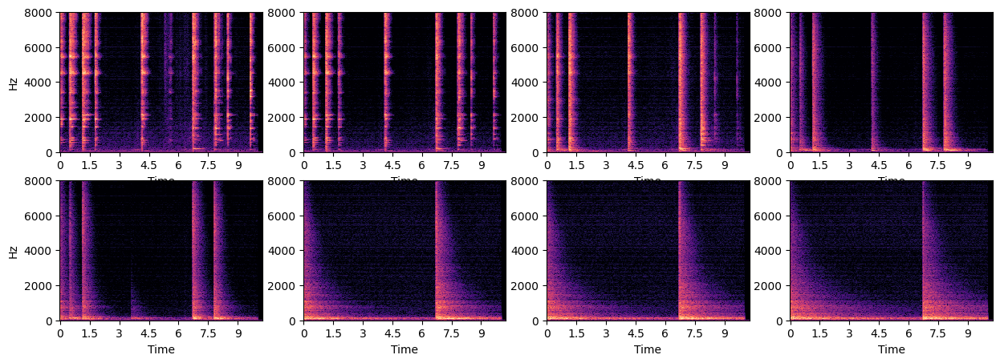

In [34]:
text = "A drumstick is continuously hitting a hard metal surface with reverb"

text = [text] * batch_size
batch = {
        "text": text,  # list
        "fname": ['some-name']  # list
}


#Attention reweight
latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(text) #print the mapping
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text([text][0])
print(context.shape)
attention_weights = torch.from_numpy(np.array([1 for i in range(context.shape[1])])).cuda()

wavs = []

interp_range = [i for i in np.arange(-2, 6, 1)]
for attention_weight in interp_range:
    attention_weights[12] = attention_weight
    attention_weights[14] = attention_weight
    print(attention_weights)

    predicted_mel, predicted_wav, predicted_noise, predicted_uncond_noise, predicted_noise_with_cfg, intermediates = \
    sample_diffusion(batch, attention_weights=attention_weights, random_seed=42)

    wavs.append(predicted_wav)
    
plot_all(wavs)

## Rate

Token for each word in sentence => [[0], [1, 2], [3], [4], [5, 6], [7], [8], [9]] torch.Size([11])
A [0]
drumstick [1, 2]
is [3]
hitting [4]
a [5, 6]
surface [7]
multiple [8]
times [9]
torch.Size([1, 11, 1024])
tensor([ 1,  1,  1,  1,  1,  1,  1,  1, -2,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.52it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.63it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.60it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 4, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.61it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 6, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.65it/s]


tensor([1, 1, 1, 1, 1, 1, 1, 1, 8, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.60it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1, 10,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.64it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1, 12,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.67it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1, 14,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.63it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1, 16,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.60it/s]


tensor([ 1,  1,  1,  1,  1,  1,  1,  1, 18,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.64it/s]


num rows= 3


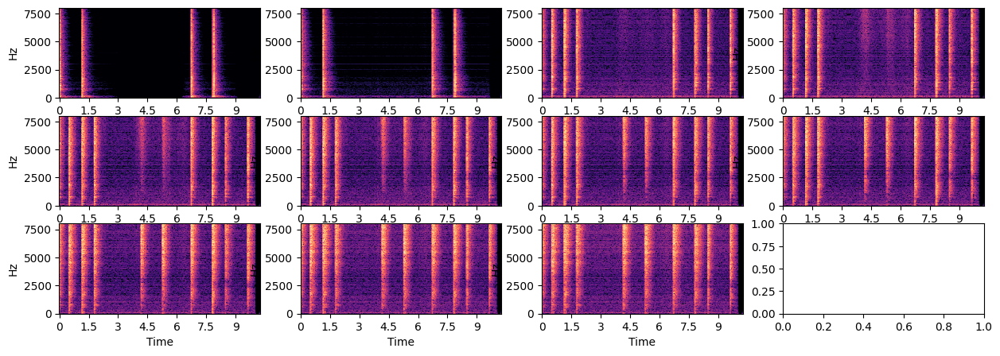

In [42]:
text = "A drumstick is hitting a surface multiple times"

text = [text] * batch_size
batch = {
        "text": text,  # list
        "fname": ['some-name']  # list
}


#Attention reweight
latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(text) #print the mapping
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text([text][0])
print(context.shape)
attention_weights = torch.from_numpy(np.array([1 for i in range(context.shape[1])])).cuda()

wavs = []

interp_range = [i for i in np.arange(-2, 20, 2)]
for attention_weight in interp_range:
    attention_weights[8] = attention_weight
    # attention_weights[9] = attention_weight
    print(attention_weights)

    predicted_mel, predicted_wav, predicted_noise, predicted_uncond_noise, predicted_noise_with_cfg, intermediates = \
    sample_diffusion(batch, attention_weights=attention_weights, random_seed=42)

    wavs.append(predicted_wav)
    
plot_all(wavs)

Token for each word in sentence => [[0], [1], [2, 3], [4], [5], [6], [7], [8]] torch.Size([10])
A [0]
dog [1]
barking [2, 3]
multiple [4]
times [5]
in [6]
the [7]
garden [8]
torch.Size([1, 10, 1024])
tensor([  1,   1,   1,   1, -10,   1,   1,   1,   1,   1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.06it/s]


tensor([ 1,  1,  1,  1, -5,  1,  1,  1,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.37it/s]


tensor([1, 1, 1, 1, 0, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.65it/s]


tensor([1, 1, 1, 1, 5, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.59it/s]


tensor([ 1,  1,  1,  1, 10,  1,  1,  1,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.64it/s]


tensor([ 1,  1,  1,  1, 15,  1,  1,  1,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.59it/s]


tensor([ 1,  1,  1,  1, 20,  1,  1,  1,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.56it/s]


num rows= 2


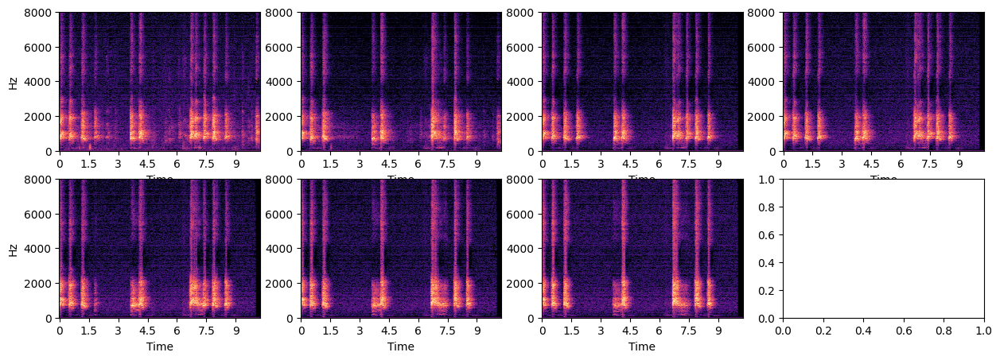

In [51]:
text = "A dog barking multiple times in the garden"

text = [text] * batch_size
batch = {
        "text": text,  # list
        "fname": ['some-name']  # list
}


#Attention reweight
latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(text) #print the mapping
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text([text][0])
print(context.shape)
attention_weights = torch.from_numpy(np.array([1 for i in range(context.shape[1])])).cuda()

wavs = []

interp_range = [i for i in np.arange(-10, 21, 5)]
for attention_weight in interp_range:
    attention_weights[4] = attention_weight
    # attention_weights[9] = attention_weight
    print(attention_weights)

    predicted_mel, predicted_wav, predicted_noise, predicted_uncond_noise, predicted_noise_with_cfg, intermediates = \
    sample_diffusion(batch, attention_weights=attention_weights, random_seed=42)

    wavs.append(predicted_wav)
    
plot_all(wavs)

Token for each word in sentence => [[0], [1], [2], [3], [4], [5]] torch.Size([7])
A [0]
person [1]
walking [2]
on [3]
crunchy [4]
snow [5]
torch.Size([1, 7, 1024])
tensor([ 1,  1,  1,  1, -5,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.14it/s]


tensor([ 1,  1,  1,  1, -4,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.31it/s]


tensor([ 1,  1,  1,  1, -3,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.31it/s]


tensor([ 1,  1,  1,  1, -2,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.30it/s]


tensor([ 1,  1,  1,  1, -1,  1,  1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.45it/s]


tensor([1, 1, 1, 1, 0, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.26it/s]


tensor([1, 1, 1, 1, 1, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.31it/s]


tensor([1, 1, 1, 1, 2, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.34it/s]


tensor([1, 1, 1, 1, 3, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.32it/s]


tensor([1, 1, 1, 1, 4, 1, 1], device='cuda:0')
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.37it/s]


num rows= 3


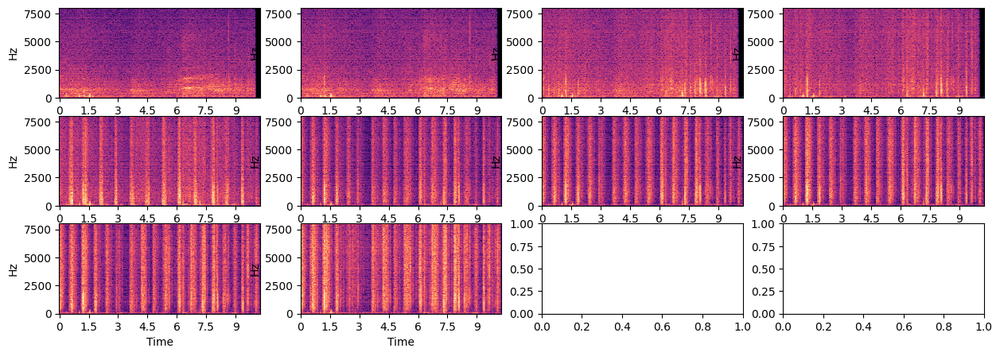

In [56]:
text = "A person walking on crunchy snow"

text = [text] * batch_size
batch = {
        "text": text,  # list
        "fname": ['some-name']  # list
}


#Attention reweight
latent_diffusion.cond_stage_models[latent_diffusion.cond_stage_model_metadata["crossattn_flan_t5"]["model_idx"]].get_words_token_mapping(text) #print the mapping
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text([text][0])
print(context.shape)
attention_weights = torch.from_numpy(np.array([1 for i in range(context.shape[1])])).cuda()

wavs = []

interp_range = [i for i in np.arange(-5, 5, 1)]
for attention_weight in interp_range:
    attention_weights[4] = attention_weight
    print(attention_weights)

    predicted_mel, predicted_wav, predicted_noise, predicted_uncond_noise, predicted_noise_with_cfg, intermediates = \
    sample_diffusion(batch, attention_weights=attention_weights, random_seed=42)

    wavs.append(predicted_wav)
    
plot_all(wavs)

word ids => [0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 10, None]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 2. 1. 1.]
x_init-ing
word ids => [0, 1, 2, 3, 4, 5, 6, 7, 8, 8, 9, 10, None]
Token for each word in sentence => [[0], [1], [2], [3], [4], [5], [6], [7], [8, 9], [10], [11]] torch.Size([13])
Running DDIM Sampling with 20 timesteps


DDIM Sampler: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  8.02it/s]


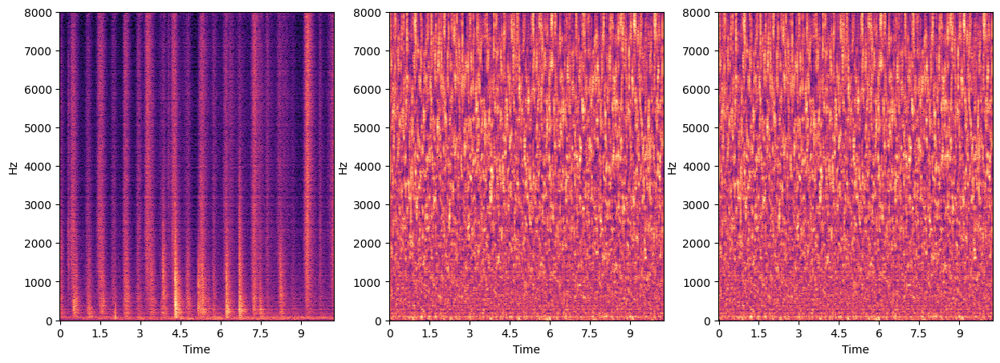

In [118]:
text_ = "A single person walking in high heels on a metal floor"

text = [text_] * batch_size
batch = {
        "text": text,  # list
        "fname": ['some-name']  # list
}


#Attention reweight
context, attn_mask = latent_diffusion.cond_stage_models[0].encode_text([text_])
attention_weights = np.array([1 for i in range(context.shape[1])]).astype(np.float32)
attention_weights[10] = 2 # num dogs
# attention_weights[1] = -5.5 # dog size
# attention_weights[2] = 0 # animal type. Try -1.5 for dog->birds
print(attention_weights)

attention_weights = torch.from_numpy(attention_weights).cuda()

predicted_mel, predicted_wav, predicted_noise, predicted_uncond_noise, predicted_noise_with_cfg, intermediates = \
sample_diffusion(batch, attention_weights=attention_weights, random_seed=1943)
plot(predicted_wav, predicted_noise, predicted_uncond_noise) 